<a href="https://colab.research.google.com/github/Konerusudhir/machine_learning_exercises/blob/master/SemanticSearchV0_2.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **Semantic Search on MakersPlace Images**

We fetch MakersPlace images and Index them using Faiss. Search is performed using Query embedding on the index. Below are the individual steps.

1.   Fetch Makers Place Contract NFT Token ids(n ...m) meta data using Alchemy 
     API. Extract previwe image URLs from the response
2.   Fetch images from URLs (IPFS Gateway). Parallell execution is used.
3.   Download Clip Model(openai/clip-vit-large-patch14) from HuggingFace and instantiate TextModel and VIsion Model.
4.   Create Index using Faiss
5.   Generate embeddings for images using Clip Model and them to index
6.   Query the index using Query Image Model Embeddings.
7.   Display search results.

## Acknowledgements
1. Search results in unintended images like NSFW images
2. This is setup is not evaluated using curated/benchmark dataset to verify
   accuracy
3. Index generation and Index search is not on GPU. Only Image embedding generation is in GPU
4. GPU Memory clean up is done manually. Need fine tuning to avoid OOM errors



In [ ]:
%%capture
!pip install web3
!pip install gql[all]
!pip install requests_toolbelt
!pip install transformers
!pip install faiss-gpu
!pip install torch
!pip install Pillow
!pip install matplotlib

In [ ]:
import os
import shutil
import math 
import glob
import json

from gql import Client, gql
from gql.transport.requests import RequestsHTTPTransport

import requests
from numpy import random
import numpy as np
import faiss

import torch

from PIL import Image
from IPython import display
import matplotlib.pyplot as plt

MP_CONTRACT_ADDRESS = "0x2963ba471e265e5f51cafafca78310fe87f8e6d1"
# IMAGES_FOLDER = "/content/drive/MyDrive/Misc/makers_place_images"
IMAGES_FOLDER = "./images"
GATEWAY_URL = "https://eth-mainnet.g.alchemy.com/nft/v2/rBshNbJGutTbf2ACdQ9XyGhhc1uSolds/getNFTMetadataBatch"
IMAGE_FETCH_HOST = "https://arweave.net"
MIN_TOKEN_ID = 2000
MAX_TOKEN_ID = 12000
QUERY_BATCH_SIZE = 100

RANDOM_SEED = 7

np.random.seed(RANDOM_SEED)

In [ ]:
def clean_directories():
  shutil.rmtree(IMAGES_FOLDER, ignore_errors=True)

def create_directories():
  if not os.path.exists(IMAGES_FOLDER):
    os.mkdir(IMAGES_FOLDER) 

# clean_directories()
create_directories()

# 1 - Transactions Fetch

In [ ]:
%%time
image_urls = []
def fetch_image_urls(min_token_id, max_toke_id):  
  token_id_requests = []
  for i in range(min_token_id, max_toke_id):
    token_id_requests.append(
      {
          "contractAddress": MP_CONTRACT_ADDRESS,
          "tokenId": f"{i}",
          "tokenType": "ERC721"
      }
    )

  payload = {
      "tokens": token_id_requests,
      "refreshCache": False
  }
  headers = {
      "accept": "application/json",
      "content-type": "application/json"
  }

  responses = requests.post(GATEWAY_URL, json=payload, headers=headers)
  nfts_metadata = json.loads(responses.text)
  
  for nft_metadata in nfts_metadata:
    properties = nft_metadata['metadata'].get('properties', None)
    if properties:
      preview_media_file = properties.get('preview_media_file', None)
      if preview_media_file:
        description = preview_media_file.get('description')
        if description:
          image_urls.append(description)

  # print(f"URLs: {image_urls}")
      
for batch_start_index in range(MIN_TOKEN_ID, MAX_TOKEN_ID, QUERY_BATCH_SIZE):
  fetch_image_urls(batch_start_index, batch_start_index+QUERY_BATCH_SIZE)

CPU times: user 2.53 s, sys: 200 ms, total: 2.73 s
Wall time: 4min 5s


# 2 - Fetch Images

In [ ]:
%%time
import time
img_local_paths = []
from concurrent.futures import ThreadPoolExecutor
def fetch_image(image_url):

  # file_name = f"{image_url.split('/')[-1]}_{time.time_ns()}.jpeg"
  file_name = image_url.split('/')[-1]
 
  image_local_path = os.path.join(IMAGES_FOLDER,file_name)
  # print(f"{image_url} -- {file_name} -- {image_local_path}")
  
  if not os.path.exists(image_local_path):    
    # print(f"Fetching... {image_url}")
    # response = requests.get(image_url, stream = True, timeout=5)
    # print(f"Response: {response}")
    # img = Image.open(response.raw)
    # display.Image(img)
    # print(f"Fetched... {img}")
    # img.save(image_local_path)
    # print(f"Saved {img}")

    response = requests.get(image_url)
    if response.status_code:
        fp = open(image_local_path, 'wb')
        fp.write(response.content)
        fp.close()
    
  img_local_paths.append(image_local_path)  
  # display.Image(image_local_path)    

  # return img_local_path


# fetch_image(image_urls[0])
with ThreadPoolExecutor(max_workers=32) as executor:
    executor.map(fetch_image, image_urls)

downloaded_images_count = len(img_local_paths)
print(f"Downloaded {downloaded_images_count} Images")
# display.Image("https://ipfsgateway.makersplace.com/ipfs/QmSnvLL8wgkFxcSdVJ7vVbiBbtAbzczN9MLmjq6BuUMg6G")

Downloaded 9249 Images
CPU times: user 1min 5s, sys: 17.7 s, total: 1min 23s
Wall time: 2min 6s


CPU times: user 2.1 s, sys: 54.1 ms, total: 2.16 s
Wall time: 2.3 s


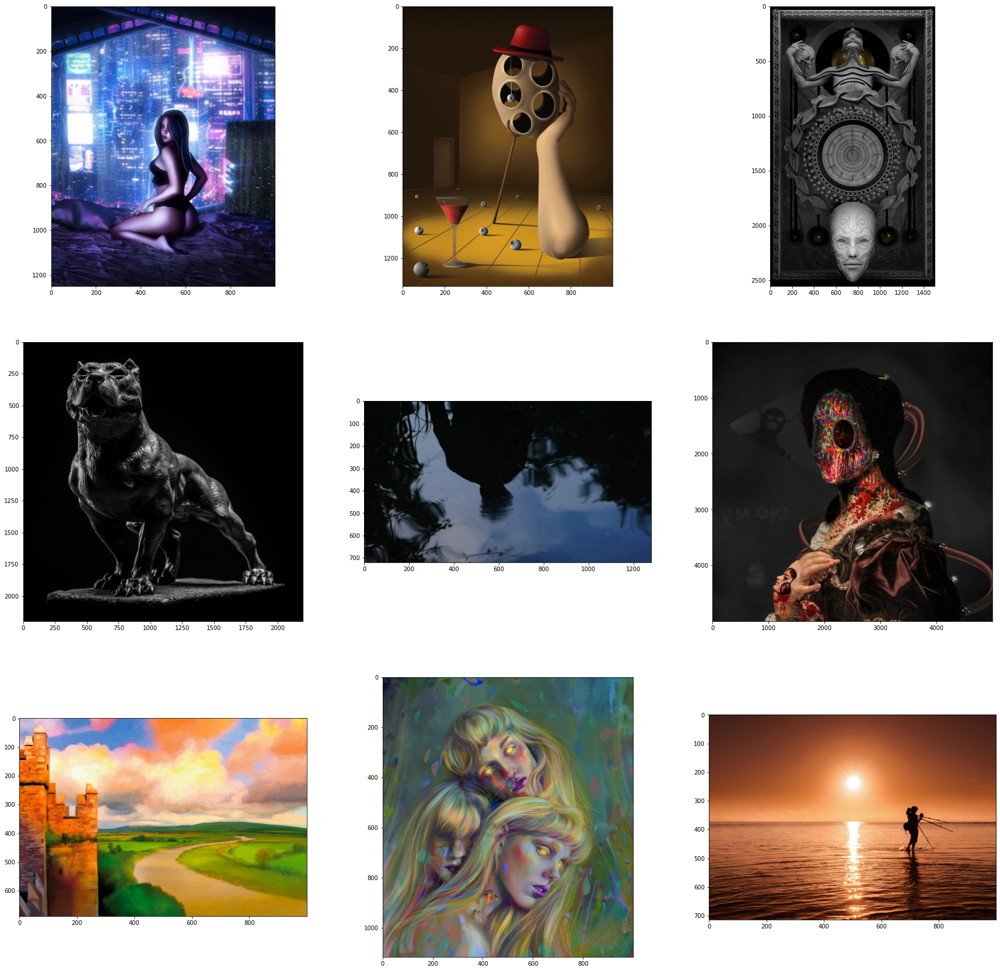

In [ ]:
%%time
def img_reshape(img_path):
    img = Image.open(img_path).convert('RGB')
    # img = img.resize((300,300))
    img = np.asarray(img)
    return img

img_local_paths = []
for imagePath in os.listdir(IMAGES_FOLDER)[:9]:
  img_local_paths.append(os.path.join(IMAGES_FOLDER, imagePath))

rows=3
cols=3
img_count = 0

fig, axes = plt.subplots(nrows=rows, ncols=cols, figsize=(30,30))
# random_image_ids = random.randint(downloaded_images_count, size=(rows*cols))
for i in range(rows):
    for j in range(cols):        
        if img_count < len(img_local_paths):
            axes[i, j].imshow(img_reshape(img_local_paths[img_count]))
            img_count+=1

# 3 - Download Clip Model

In [ ]:
%%time
from transformers import CLIPTokenizer, CLIPTextModelWithProjection, CLIPProcessor, CLIPVisionModelWithProjection, TFCLIPTextModel, TFCLIPVisionModel

DIMENSIONS = 768
clip_model_id = "openai/clip-vit-large-patch14"

text_model = CLIPTextModelWithProjection.from_pretrained(clip_model_id)
tokenizer = CLIPTokenizer.from_pretrained(clip_model_id)

vision_model = CLIPVisionModelWithProjection.from_pretrained(clip_model_id)
processor = CLIPProcessor.from_pretrained(clip_model_id)

device = torch.device("cuda") if torch.cuda.is_available() else torch.device("cpu")
vision_model.to(device)

Some weights of the model checkpoint at openai/clip-vit-large-patch14 were not used when initializing CLIPTextModelWithProjection: ['vision_model.encoder.layers.7.mlp.fc2.weight', 'vision_model.encoder.layers.21.mlp.fc2.bias', 'vision_model.encoder.layers.1.self_attn.out_proj.bias', 'vision_model.encoder.layers.23.self_attn.out_proj.bias', 'vision_model.encoder.layers.3.self_attn.v_proj.bias', 'vision_model.encoder.layers.11.mlp.fc1.weight', 'vision_model.encoder.layers.22.self_attn.v_proj.weight', 'vision_model.encoder.layers.14.self_attn.q_proj.bias', 'vision_model.encoder.layers.8.mlp.fc1.weight', 'vision_model.encoder.layers.14.mlp.fc2.bias', 'vision_model.encoder.layers.4.mlp.fc2.weight', 'vision_model.encoder.layers.10.self_attn.k_proj.bias', 'vision_model.encoder.layers.14.self_attn.q_proj.weight', 'vision_model.encoder.layers.5.mlp.fc1.weight', 'vision_model.encoder.layers.23.mlp.fc1.weight', 'vision_model.encoder.layers.17.self_attn.q_proj.bias', 'vision_model.encoder.layers.1

CPU times: user 10 s, sys: 6.73 s, total: 16.8 s
Wall time: 29.6 s


CLIPVisionModelWithProjection(
  (vision_model): CLIPVisionTransformer(
    (embeddings): CLIPVisionEmbeddings(
      (patch_embedding): Conv2d(3, 1024, kernel_size=(14, 14), stride=(14, 14), bias=False)
      (position_embedding): Embedding(257, 1024)
    )
    (pre_layrnorm): LayerNorm((1024,), eps=1e-05, elementwise_affine=True)
    (encoder): CLIPEncoder(
      (layers): ModuleList(
        (0): CLIPEncoderLayer(
          (self_attn): CLIPAttention(
            (k_proj): Linear(in_features=1024, out_features=1024, bias=True)
            (v_proj): Linear(in_features=1024, out_features=1024, bias=True)
            (q_proj): Linear(in_features=1024, out_features=1024, bias=True)
            (out_proj): Linear(in_features=1024, out_features=1024, bias=True)
          )
          (layer_norm1): LayerNorm((1024,), eps=1e-05, elementwise_affine=True)
          (mlp): CLIPMLP(
            (activation_fn): QuickGELUActivation()
            (fc1): Linear(in_features=1024, out_features=4096,

# 4 - Create Faiss Index

In [ ]:
image_names = [name for name in os.listdir(IMAGES_FOLDER) if os.path.isfile(os.path.join(IMAGES_FOLDER, name))]
total_images_count = len(image_names)
storage = "Flat"
# cells = min(round(math.sqrt(total_images_count)), int(total_images_count/39))
cells = 5
# params = f"IVF{cells},{storage}"
params = f"IDMap,{storage}"
index = faiss.index_factory(DIMENSIONS, params)

print(f"Total Images: {total_images_count}")

Total Images: 5547


In [ ]:
def get_text_embeds(queries):
  inputs = tokenizer(queries, padding=True, return_tensors="pt")
  outputs = text_model(**inputs)
  return outputs.text_embeds.detach().numpy()

print(get_text_embeds(["a photo of a cat", "a photo of a dog"]).shape)

(2, 768)


# 5 - Index Images

In [ ]:
%%time
image_ids_map = {}
image_embeds = None

with torch.no_grad():
    torch.cuda.empty_cache()

def get_embeds(images):
  inputs = processor(images=images, return_tensors="pt")
  inputs = inputs.to(device)
  outputs = vision_model(**inputs)
  return outputs.image_embeds #.detach().numpy()

def build_index():
  
  batch_size = 8
  image_batch = []
  image_ids = []
  first_batch = True
  for imagePath in os.listdir(IMAGES_FOLDER):
    
    inputPath = os.path.join(IMAGES_FOLDER, imagePath)    
    image_batch.append(img_reshape(inputPath))
    hash_value = hash(inputPath)
    image_ids.append(hash_value)
    image_ids_map[hash_value] = inputPath

    if len(image_batch) == batch_size:     
      image_embeds_batch = get_embeds(image_batch)
      print(image_embeds_batch.shape)
      image_embeds_batch = image_embeds_batch.to(torch.device("cpu"))        
      # if first_batch:
      # index.train(image_embeds_batch.detach().numpy())
      # first_batch = False

      index.add_with_ids(image_embeds_batch.detach().numpy(), np.array(image_ids))
      image_ids = []
      image_batch = []


image_embeds = build_index()


torch.Size([8, 768])
torch.Size([8, 768])
torch.Size([8, 768])
torch.Size([8, 768])
torch.Size([8, 768])
torch.Size([8, 768])
torch.Size([8, 768])
torch.Size([8, 768])
torch.Size([8, 768])
torch.Size([8, 768])
torch.Size([8, 768])
torch.Size([8, 768])
torch.Size([8, 768])
torch.Size([8, 768])
torch.Size([8, 768])
torch.Size([8, 768])
torch.Size([8, 768])
torch.Size([8, 768])
torch.Size([8, 768])
torch.Size([8, 768])
torch.Size([8, 768])
torch.Size([8, 768])
torch.Size([8, 768])
torch.Size([8, 768])
torch.Size([8, 768])
torch.Size([8, 768])
torch.Size([8, 768])
torch.Size([8, 768])
torch.Size([8, 768])
torch.Size([8, 768])
torch.Size([8, 768])
torch.Size([8, 768])
torch.Size([8, 768])
torch.Size([8, 768])
torch.Size([8, 768])
torch.Size([8, 768])
torch.Size([8, 768])
torch.Size([8, 768])
torch.Size([8, 768])
torch.Size([8, 768])
torch.Size([8, 768])
torch.Size([8, 768])
torch.Size([8, 768])
torch.Size([8, 768])
torch.Size([8, 768])
torch.Size([8, 768])
torch.Size([8, 768])
torch.Size([8

/usr/local/lib/python3.8/dist-packages/PIL/Image.py:2797: DecompressionBombWarning: Image size (94133724 pixels) exceeds limit of 89478485 pixels, could be decompression bomb DOS attack.
  warnings.warn(


torch.Size([8, 768])
torch.Size([8, 768])
torch.Size([8, 768])
torch.Size([8, 768])
torch.Size([8, 768])
torch.Size([8, 768])
torch.Size([8, 768])
torch.Size([8, 768])
torch.Size([8, 768])
torch.Size([8, 768])
torch.Size([8, 768])
torch.Size([8, 768])
torch.Size([8, 768])
torch.Size([8, 768])
torch.Size([8, 768])
torch.Size([8, 768])
torch.Size([8, 768])
torch.Size([8, 768])
torch.Size([8, 768])
torch.Size([8, 768])
torch.Size([8, 768])
torch.Size([8, 768])
torch.Size([8, 768])
torch.Size([8, 768])
torch.Size([8, 768])
torch.Size([8, 768])
torch.Size([8, 768])
torch.Size([8, 768])
torch.Size([8, 768])
torch.Size([8, 768])
torch.Size([8, 768])
torch.Size([8, 768])
torch.Size([8, 768])
torch.Size([8, 768])
torch.Size([8, 768])
torch.Size([8, 768])
torch.Size([8, 768])
torch.Size([8, 768])
torch.Size([8, 768])
torch.Size([8, 768])
torch.Size([8, 768])
torch.Size([8, 768])
torch.Size([8, 768])
torch.Size([8, 768])
torch.Size([8, 768])
torch.Size([8, 768])
torch.Size([8, 768])
torch.Size([8

DecompressionBombError: ignored

# 6 - Query Index

In [ ]:
%%time
# searh_embeds = get_text_embeds(["Illustration"])
searh_embeds = get_embeds(img_reshape(img_local_paths[1])).cpu().detach().numpy()
print(searh_embeds.shape)
# faiss.normalize_L2(searh_embeds)

probabilities, ids = index.search(searh_embeds, 16)
print(ids)
print(probabilities)


(1, 768)
[[ 8772378321723019443 -3333445447593679809  2054020272530199574
  -1989015697183121160 -8057479829496183877 -9170067178428576542
   7582298186389547037  7046453665620724933  -758126548190403676
   5893064666282619489  8034421080868828431 -3235427682229286462
  -3294573465388054273  -143799055461639492 -5825499484192118632
  -2234117982922967350]]
[[6.1276551e-10 1.4984013e+02 1.5520216e+02 1.6572035e+02 1.6856642e+02
  1.7187929e+02 1.7900352e+02 1.8039012e+02 1.8066266e+02 1.8088167e+02
  1.8488667e+02 1.8773689e+02 1.8960638e+02 1.9173035e+02 1.9256369e+02
  1.9320085e+02]]
CPU times: user 155 ms, sys: 2.88 ms, total: 158 ms
Wall time: 159 ms


# 7 - Display Results

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
ERROR: Could not find a version that satisfies the requirement cudatoolkit (from versions: none)
ERROR: No matching distribution found for cudatoolkit


<timed exec>:8: NumbaWarning: 
Compilation is falling back to object mode WITH looplifting enabled because Function "display_results" failed type inference due to: Untyped global name 'image_ids_map': Cannot determine Numba type of <class 'dict'>

File "<timed exec>", line 15:
<source missing, REPL/exec in use?>

<timed exec>:8: NumbaWarning: 
Compilation is falling back to object mode WITHOUT looplifting enabled because Function "display_results" failed type inference due to: Cannot determine Numba type of <class 'numba.core.dispatcher.LiftedLoop'>

File "<timed exec>", line 12:
<source missing, REPL/exec in use?>

/usr/local/lib/python3.8/dist-packages/numba/core/object_mode_passes.py:151: NumbaWarning: Function "display_results" was compiled in object mode without forceobj=True, but has lifted loops.

File "<timed exec>", line 10:
<source missing, REPL/exec in use?>

  warnings.warn(errors.NumbaWarning(warn_msg,
/usr/local/lib/python3.8/dist-packages/numba/core/object_mode_passes.py

CPU times: user 1.78 s, sys: 221 ms, total: 2 s
Wall time: 6.61 s


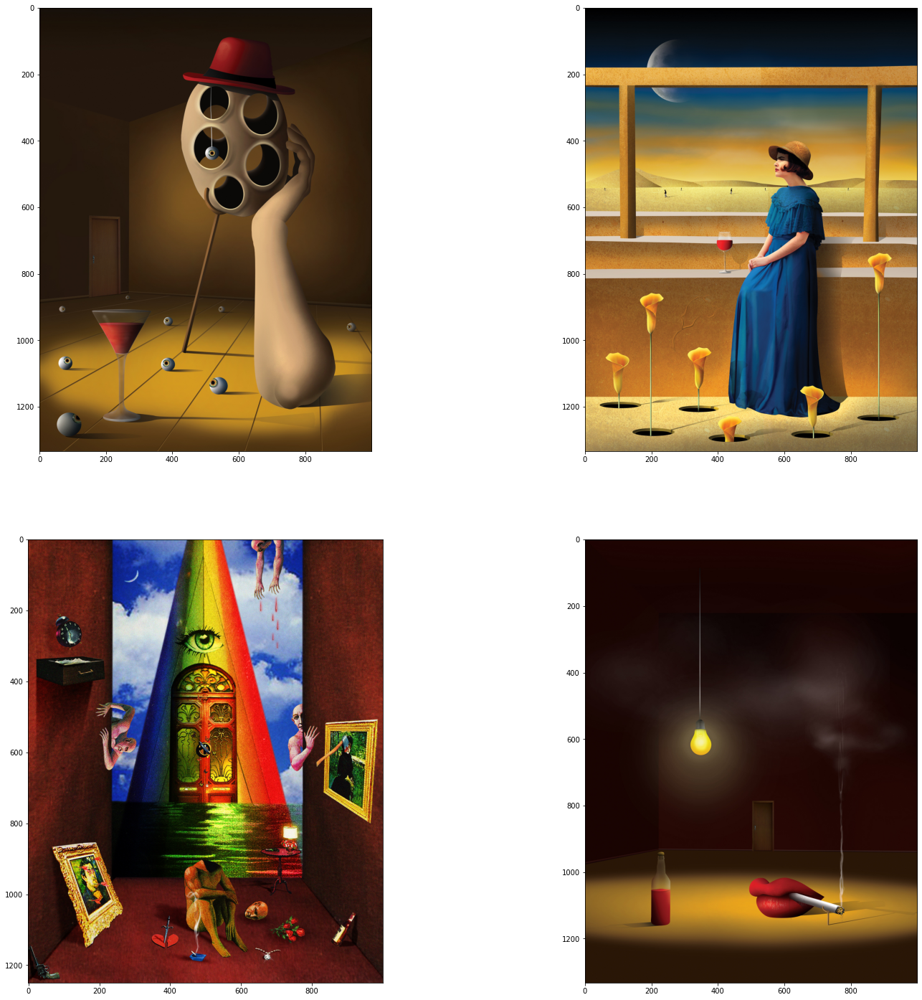

In [ ]:
%%time
!pip install numba & pip install cudatoolkit
from numba import jit, cuda


rows=2
cols=2

@jit(target_backend='cuda') 
def display_results(search_results):
  img_count = 0
  fig, axes = plt.subplots(nrows=rows, ncols=cols, figsize=(25,25))
  for i in range(rows):
      for j in range(cols):        
          if img_count < len(search_results[0]):
              path = image_ids_map[search_results[0][img_count]]
              axes[i, j].imshow(img_reshape(path))
              img_count+=1

display_results(ids)            



Results for Images search 2884


Results for Images search 3267


Results for Images search 3588


Results for Images search 4330


Results for Images search 2874


Results for Images search 4720


Results for Images search 5048


Results for Images search 1866


Results for Images search 3144


Results for Images search 1885


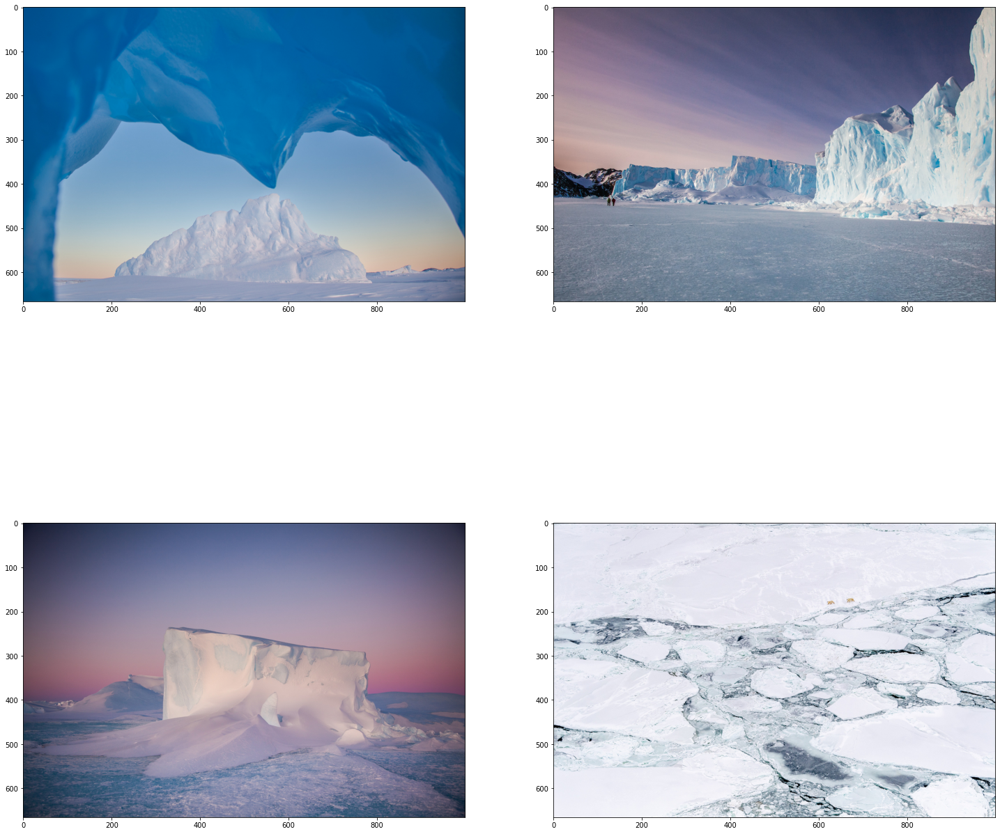

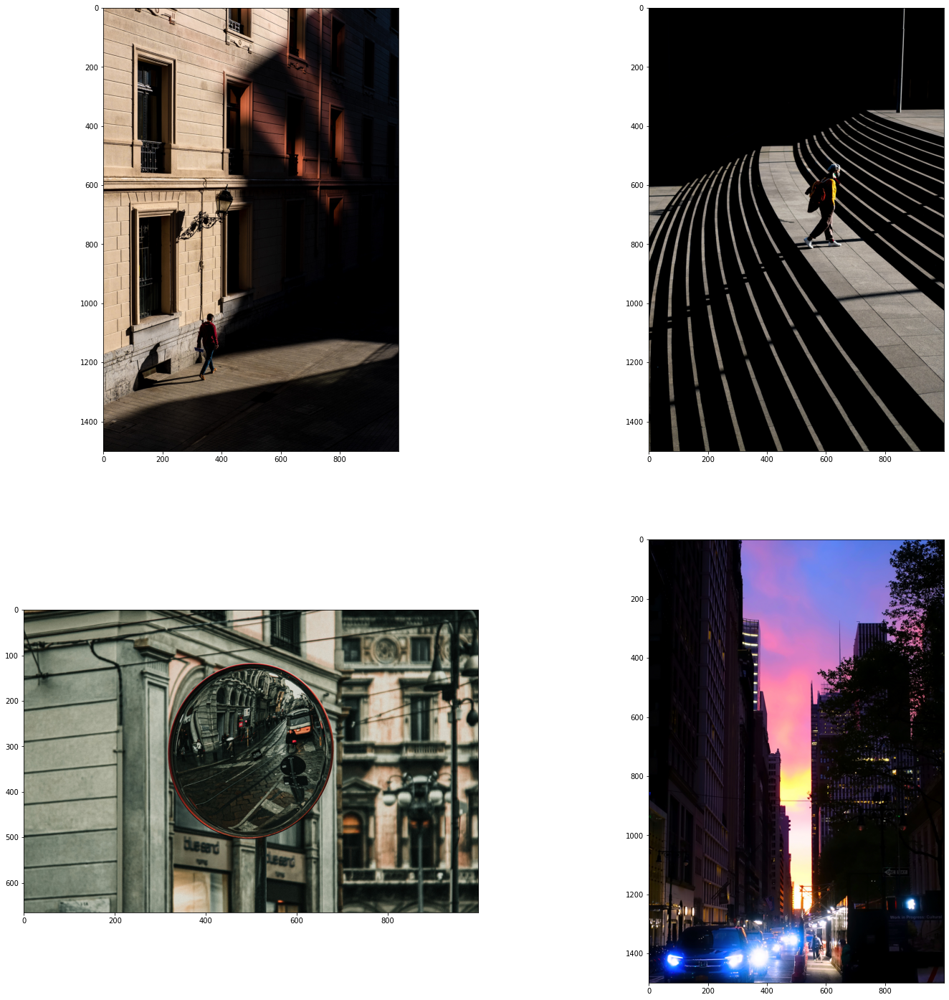

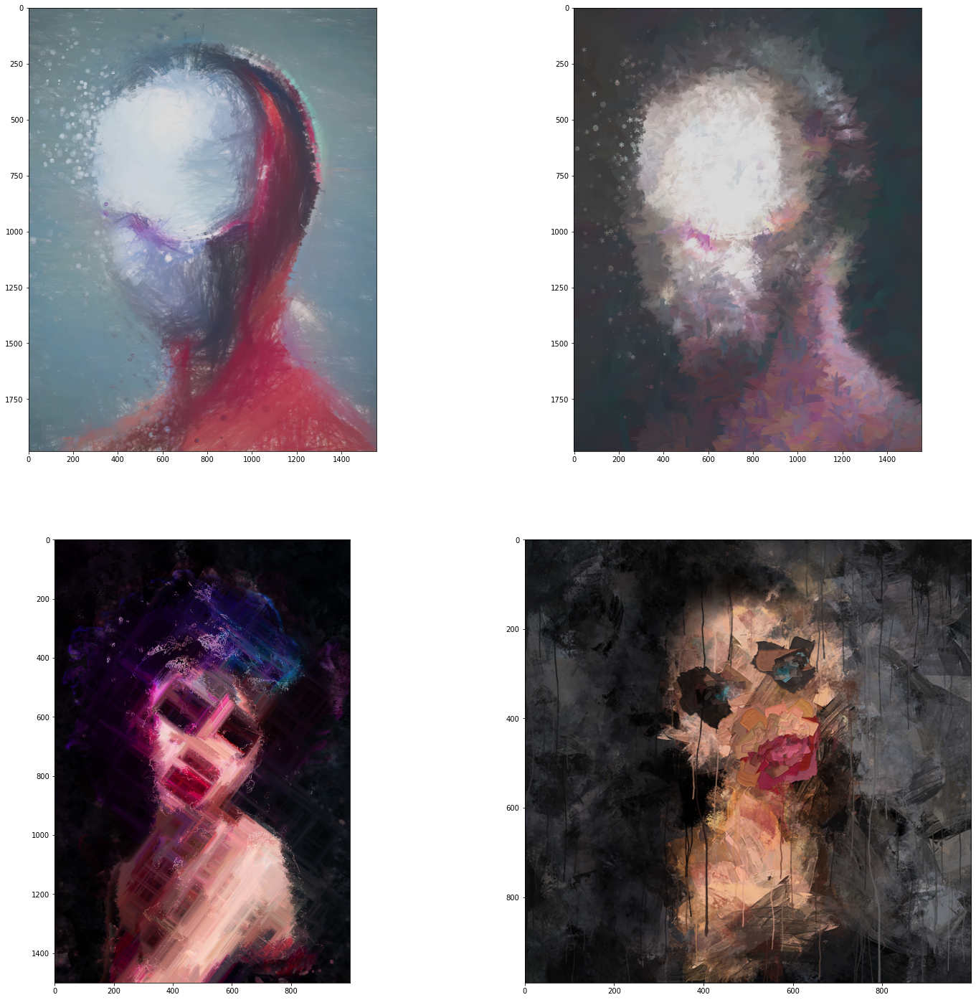

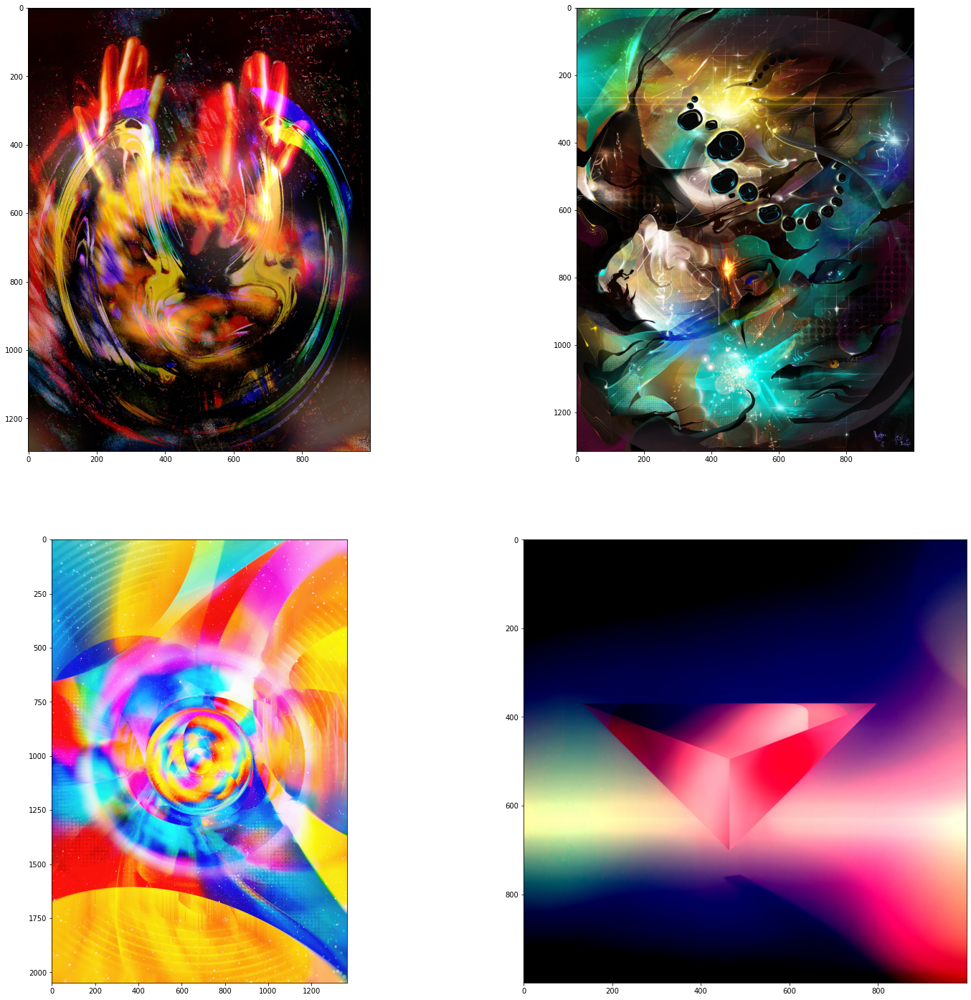

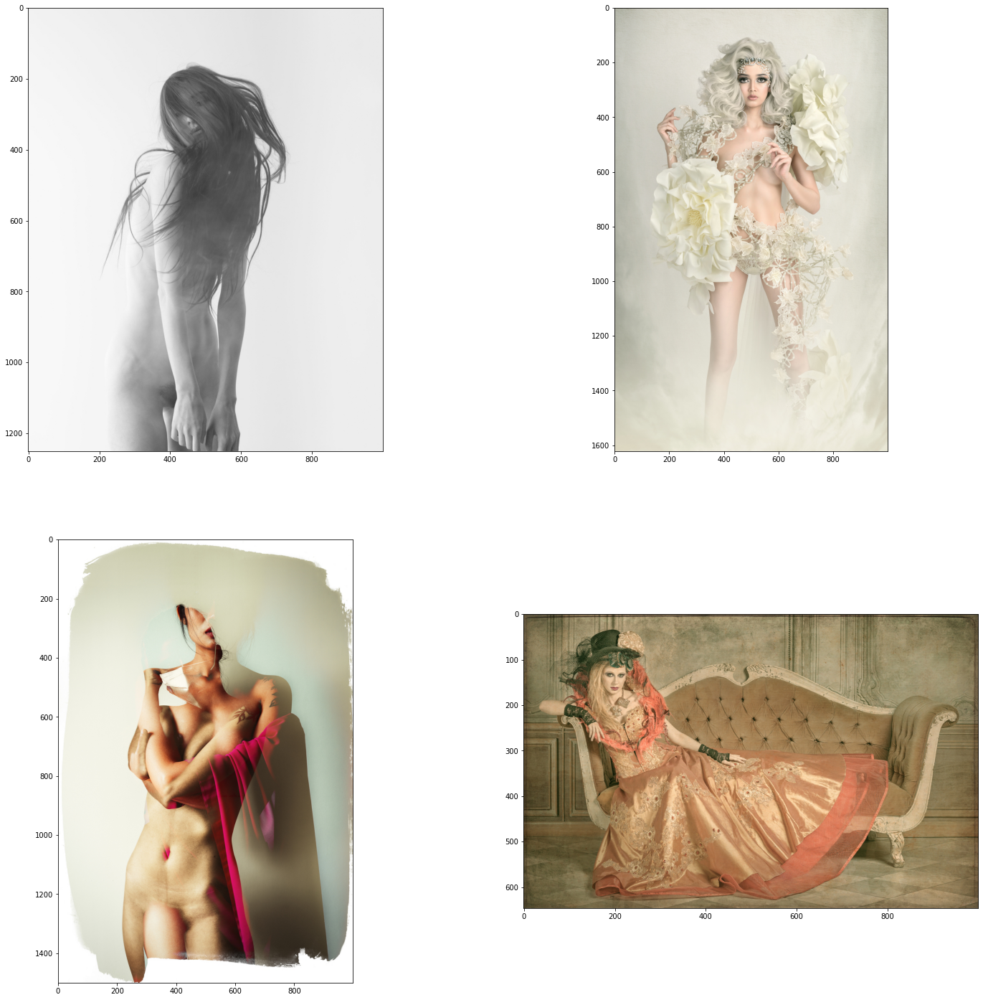

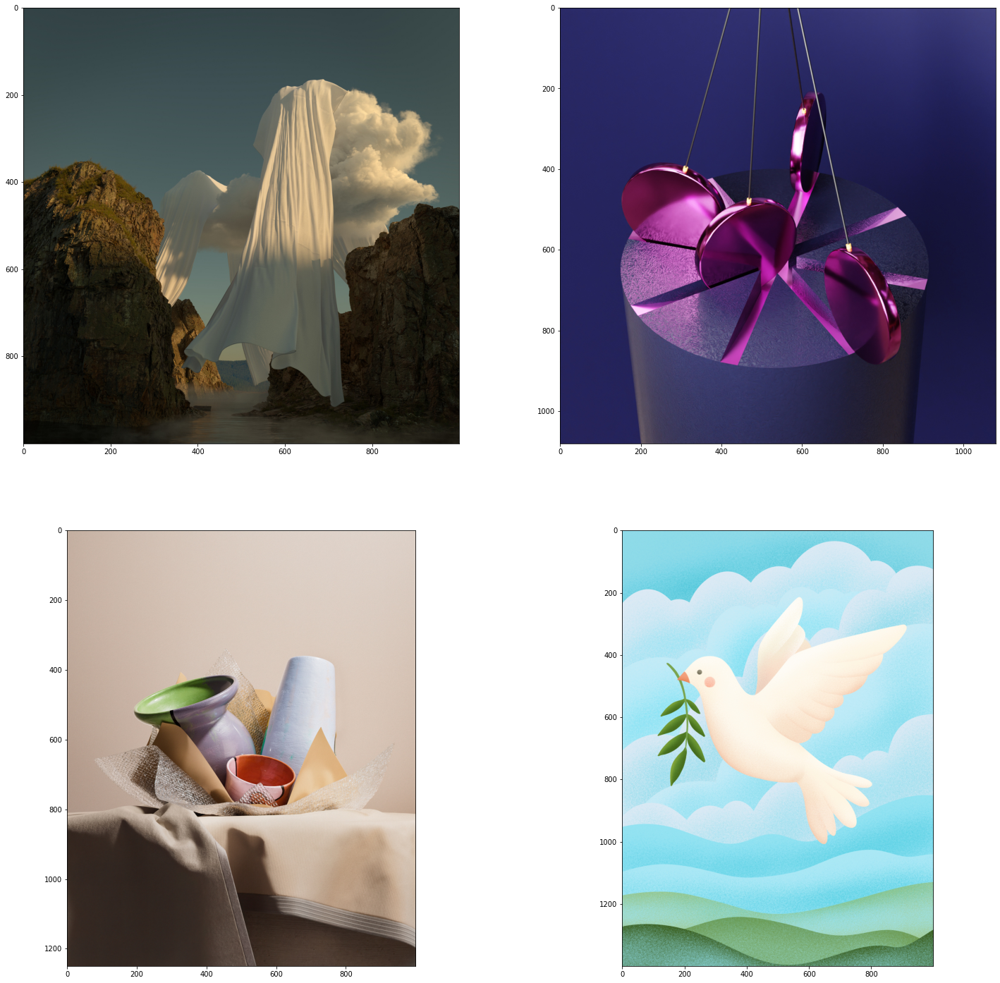

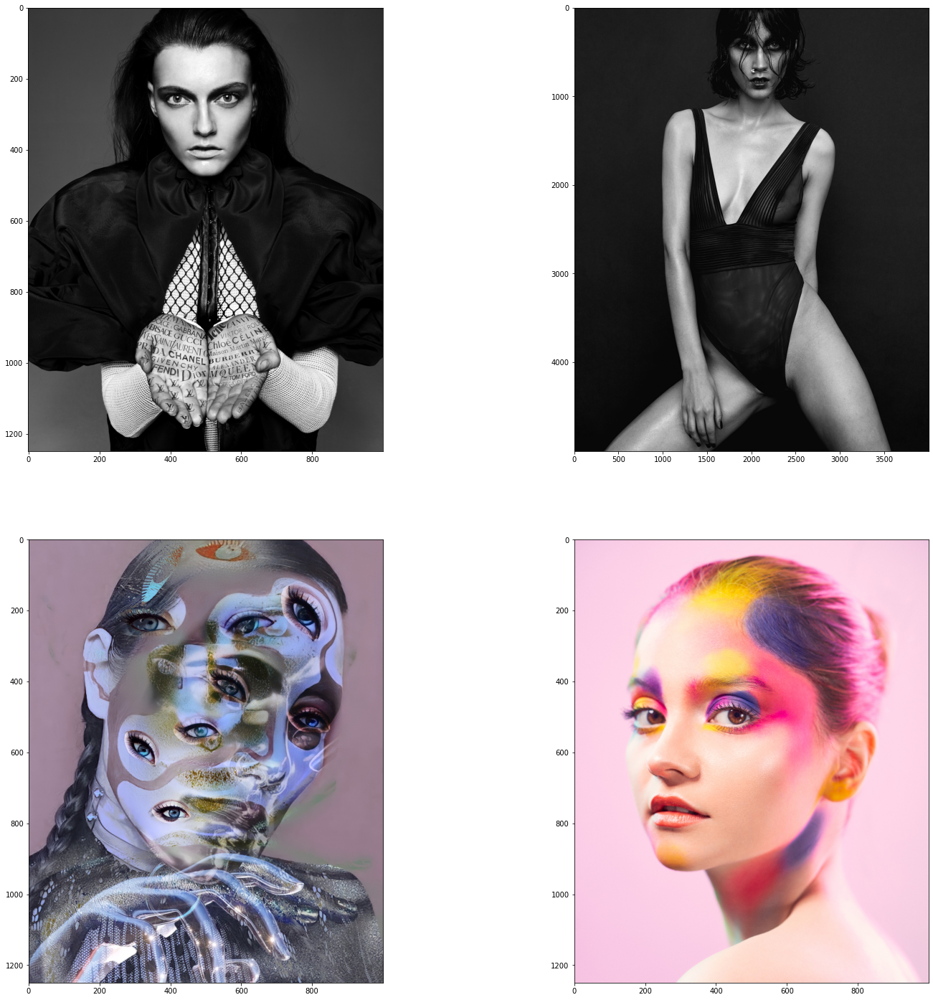

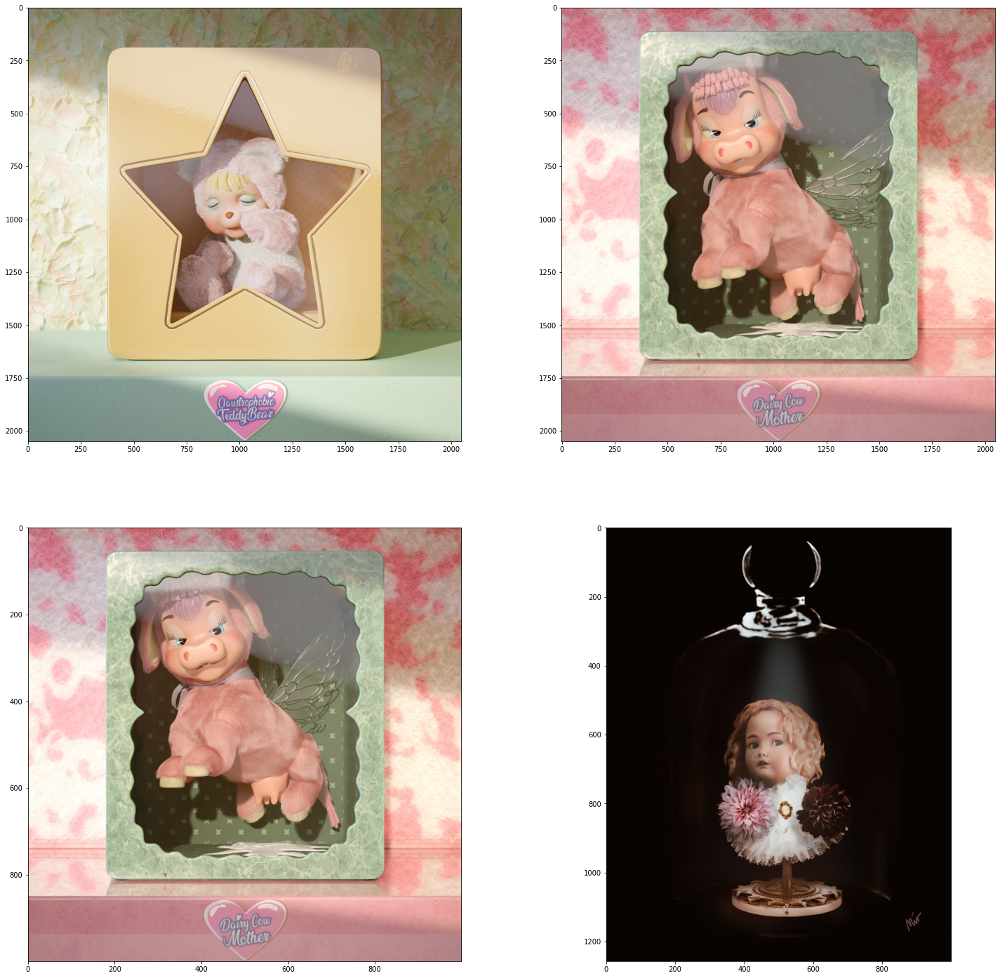

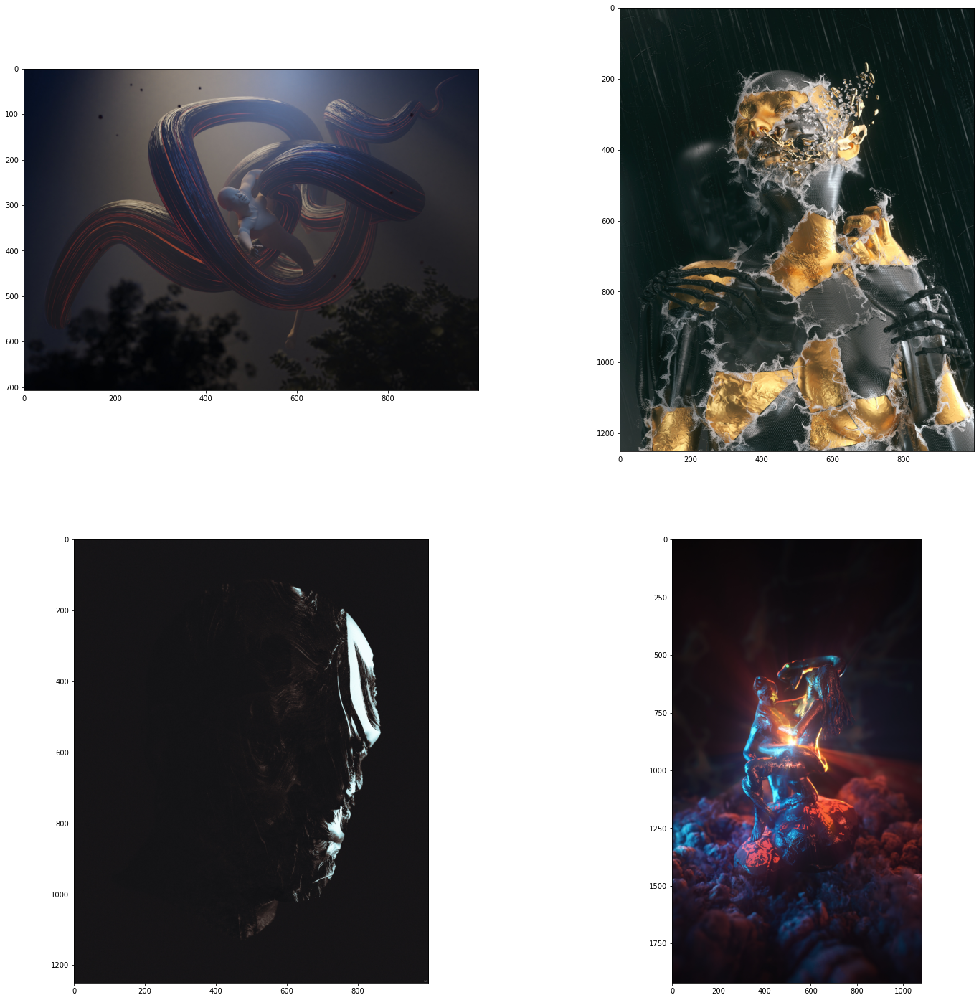

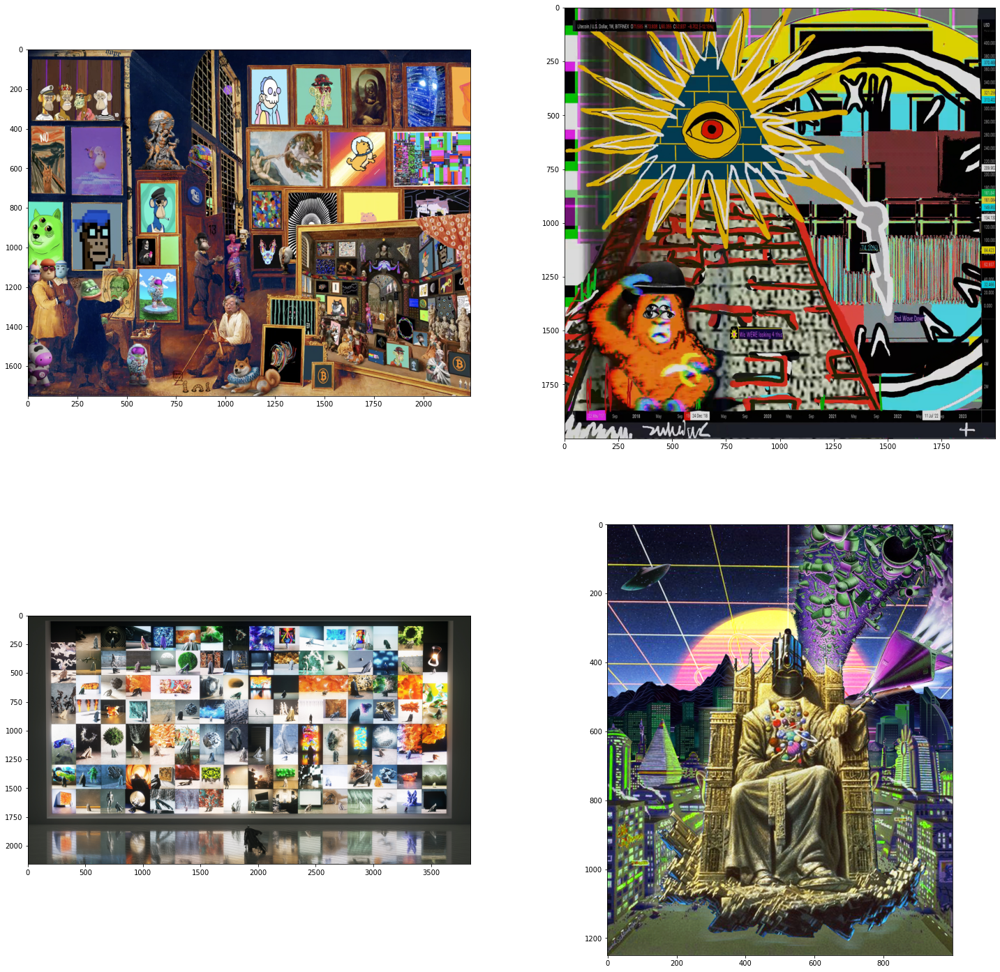

In [ ]:

search_images = np.random.randint(0, len(image_names), 10)
for i in search_images:
  image_path = os.path.join(IMAGES_FOLDER,image_names[i])
  searh_embeds = get_embeds(img_reshape(image_path)).cpu().detach().numpy()
  _, image_ids = index.search(searh_embeds, 4)
  print(f"\n\nResults for Images search {i}")
  display_results(image_ids)  


In [ ]:

torch.cuda.empty_cache()